===== IMPORT DEBUG INFO =====
CWD: E:\JupyterLocal\Eye_Tracking_Pipeline\eye_pipeline\GitHub_Eyepipeline

First 5 sys.path entries:
  C:\Users\tjing\AppData\Local\Programs\Python\Python313\python313.zip
  C:\Users\tjing\AppData\Local\Programs\Python\Python313\DLLs
  C:\Users\tjing\AppData\Local\Programs\Python\Python313\Lib
  C:\Users\tjing\AppData\Local\Programs\Python\Python313
  

--- Module Locations ---
eye_ops package: E:\JupyterLocal\Eye_Tracking_Pipeline\eye_pipeline\GitHub_Eyepipeline\eye_ops
settings.py: E:\JupyterLocal\Eye_Tracking_Pipeline\eye_pipeline\GitHub_Eyepipeline\eye_ops\settings.py
io_images.py: E:\JupyterLocal\Eye_Tracking_Pipeline\eye_pipeline\GitHub_Eyepipeline\eye_pipeline\io_images.py
pipeline_2pass.py: E:\JupyterLocal\Eye_Tracking_Pipeline\eye_pipeline\GitHub_Eyepipeline\eye_pipeline\pipeline_2pass.py
report.py: E:\JupyterLocal\Eye_Tracking_Pipeline\eye_pipeline\GitHub_Eyepipeline\eye_pipeline\report.py
===== END DEBUG INFO =====

Loaded 10 images from E:\Jup

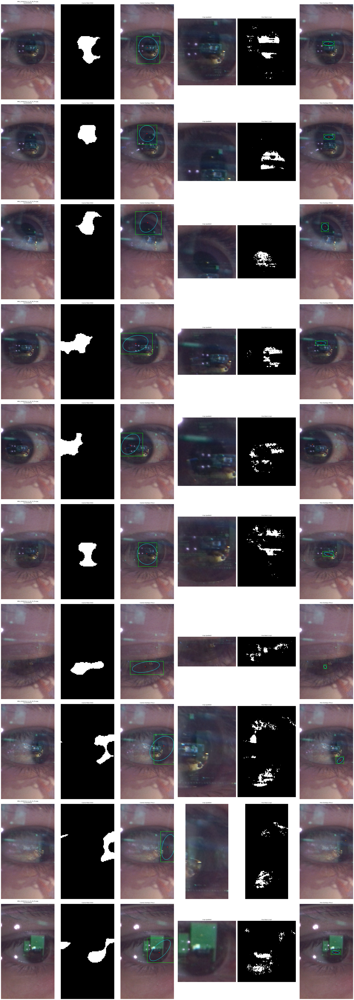

In [1]:
import sys
import os
import inspect

print("===== IMPORT DEBUG INFO =====")

print("CWD:", os.getcwd())
print("\nFirst 5 sys.path entries:")
for p in sys.path[:5]:
    print(" ", p)

print("\n--- Module Locations ---")

import eye_ops
import eye_pipeline
from eye_ops import settings as S
from eye_pipeline import io_images
from eye_pipeline import pipeline_2pass
from eye_pipeline import report

print("eye_ops package:", os.path.dirname(inspect.getfile(eye_ops)))
print("settings.py:", inspect.getfile(S))
print("io_images.py:", inspect.getfile(io_images))
print("pipeline_2pass.py:", inspect.getfile(pipeline_2pass))
print("report.py:", inspect.getfile(report))

print("===== END DEBUG INFO =====\n")


from eye_ops import settings as S
from eye_pipeline.io_images import load_rotated_images
from eye_pipeline.pipeline_2pass import run_pipeline_batch
from eye_pipeline.report import print_timing_summary

ROTATED_IMAGES, ROTATED_PATHS = load_rotated_images(max_images=200)
print("Loaded:", len(ROTATED_IMAGES))

imgs = ROTATED_IMAGES[:min(len(ROTATED_IMAGES), S.MAX_SHOW)]

PUPIL_RESULTS, TIMINGS, total_runtime = run_pipeline_batch(imgs)

print(f"Processed {len(PUPIL_RESULTS)} images.")
print_timing_summary(TIMINGS, total_runtime)


# ==============================
# Cell 2C — Storyboard View (Full -> Coarse -> Crop -> Fine)
# ==============================

import matplotlib.pyplot as plt
import cv2

from eye_ops.overlay import draw_pupil_overlay_on_full
from eye_ops.crop_map import crop_rotated_by_green_bbox, apply_padding
from eye_ops import settings as S

rows = len(PUPIL_RESULTS)
plt.figure(figsize=(36, rows * 10.0))  # 6 cols

for r, res in enumerate(PUPIL_RESULTS):
    full = ROTATED_IMAGES[r]
    title = ROTATED_PATHS[r].name if "ROTATED_PATHS" in globals() else f"img_{r}"

    coarse = res.get("coarse", None)
    fine = res

    # --- ensure we have a crop image (prefer stored) ---
    crop_bgr = res.get("crop_bgr", None)
    if crop_bgr is None:
        src_for_crop = coarse if coarse is not None else fine
        _, bb = crop_rotated_by_green_bbox(full, src_for_crop)
        if bb is not None:
            bb_pad = apply_padding(bb, full.shape, S.PAD_PX, S.PAD_REL)
            if bb_pad is not None:
                X0, Y0, X1, Y1 = bb_pad
                crop_bgr = full[Y0:Y1, X0:X1].copy()

    # --- overlays mapped onto FULL image ---
    full_coarse_viz = draw_pupil_overlay_on_full(full, coarse, draw_bbox=True) if coarse else full.copy()
    full_fine_viz   = draw_pupil_overlay_on_full(full, fine,   draw_bbox=True) if fine else full.copy()

    # --- Column 1: Full rotated ---
    ax = plt.subplot(rows, 6, r*6 + 1)
    ax.imshow(cv2.cvtColor(full, cv2.COLOR_BGR2RGB))
    ax.set_title(f"{title}\nFull ROTATED", fontsize=9)
    ax.axis("off")

    # --- Column 2: Coarse mask (ROI space) ---
    ax = plt.subplot(rows, 6, r*6 + 2)
    if coarse is not None:
        ax.imshow(coarse["mask_pct"], cmap="gray")
        ax.set_title("Coarse Mask (ROI)", fontsize=9)
    else:
        ax.set_title("Coarse Mask: None", fontsize=9)
    ax.axis("off")

    # --- Column 3: Coarse overlays on FULL ---
    ax = plt.subplot(rows, 6, r*6 + 3)
    ax.imshow(cv2.cvtColor(full_coarse_viz, cv2.COLOR_BGR2RGB))
    ax.set_title("Coarse Overlays (FULL)", fontsize=9)
    ax.axis("off")

    # --- Column 4: Cropped (padded) ---
    ax = plt.subplot(rows, 6, r*6 + 4)
    if crop_bgr is not None:
        ax.imshow(cv2.cvtColor(crop_bgr, cv2.COLOR_BGR2RGB))
        ax.set_title("Crop (padded)", fontsize=9)
    else:
        ax.set_title("Crop: None", fontsize=9)
    ax.axis("off")

    # --- Column 5: Fine mask (crop space) ---
    ax = plt.subplot(rows, 6, r*6 + 5)
    ax.imshow(fine["mask_pct"], cmap="gray")
    ax.set_title("Fine Mask (crop)", fontsize=9)
    ax.axis("off")

    # --- Column 6: Fine overlays on FULL ---
    ax = plt.subplot(rows, 6, r*6 + 6)
    ax.imshow(cv2.cvtColor(full_fine_viz, cv2.COLOR_BGR2RGB))
    ax.set_title("Fine Overlays (FULL)", fontsize=9)
    ax.axis("off")

plt.tight_layout()
plt.show()


### MASK DESNITY MAP

===== IMPORT DEBUG INFO =====
CWD: E:\JupyterLocal\Eye_Tracking_Pipeline\eye_pipeline\GitHub_Eyepipeline

First 5 sys.path entries:
  C:\Users\tjing\AppData\Local\Programs\Python\Python313\python313.zip
  C:\Users\tjing\AppData\Local\Programs\Python\Python313\DLLs
  C:\Users\tjing\AppData\Local\Programs\Python\Python313\Lib
  C:\Users\tjing\AppData\Local\Programs\Python\Python313
  

--- Module Locations ---
eye_ops package: E:\JupyterLocal\Eye_Tracking_Pipeline\eye_pipeline\GitHub_Eyepipeline\eye_ops
settings.py: E:\JupyterLocal\Eye_Tracking_Pipeline\eye_pipeline\GitHub_Eyepipeline\eye_ops\settings.py
io_images.py: E:\JupyterLocal\Eye_Tracking_Pipeline\eye_pipeline\GitHub_Eyepipeline\eye_pipeline\io_images.py
pipeline_2pass.py: E:\JupyterLocal\Eye_Tracking_Pipeline\eye_pipeline\GitHub_Eyepipeline\eye_pipeline\pipeline_2pass.py
report.py: E:\JupyterLocal\Eye_Tracking_Pipeline\eye_pipeline\GitHub_Eyepipeline\eye_pipeline\report.py
===== END DEBUG INFO =====

Loaded 10 images from E:\Jup

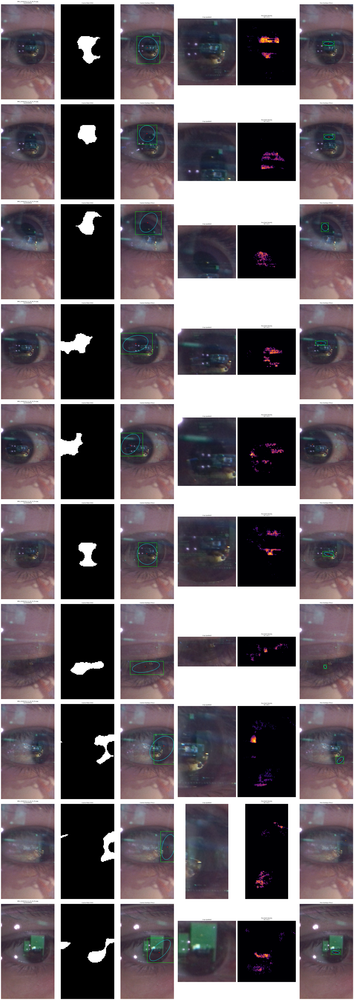

In [1]:
import sys
import os
import inspect

print("===== IMPORT DEBUG INFO =====")

print("CWD:", os.getcwd())
print("\nFirst 5 sys.path entries:")
for p in sys.path[:5]:
    print(" ", p)

print("\n--- Module Locations ---")

import eye_ops
import eye_pipeline
from eye_ops import settings as S
from eye_pipeline import io_images
from eye_pipeline import pipeline_2pass
from eye_pipeline import report

print("eye_ops package:", os.path.dirname(inspect.getfile(eye_ops)))
print("settings.py:", inspect.getfile(S))
print("io_images.py:", inspect.getfile(io_images))
print("pipeline_2pass.py:", inspect.getfile(pipeline_2pass))
print("report.py:", inspect.getfile(report))

print("===== END DEBUG INFO =====\n")



import numpy as np
import cv2

def dark_density_map(gray, pct=10, blur_k=11):
    # blur like the mask does
    if blur_k % 2 == 0:
        blur_k += 1
    g = cv2.GaussianBlur(gray, (blur_k, blur_k), 0)
    thr = float(np.percentile(g, pct))

    # soft score: how much darker than threshold (clamped)
    score = (thr - g).astype(np.float32)
    score[score < 0] = 0

    # normalize for display
    if score.max() > 1e-6:
        score = score / score.max()

    # uint8 heatmap (0..255)
    return (score * 255).astype(np.uint8), thr



from eye_ops import settings as S
from eye_pipeline.io_images import load_rotated_images
from eye_pipeline.pipeline_2pass import run_pipeline_batch
from eye_pipeline.report import print_timing_summary

ROTATED_IMAGES, ROTATED_PATHS = load_rotated_images(max_images=200)
print("Loaded:", len(ROTATED_IMAGES))

imgs = ROTATED_IMAGES[:min(len(ROTATED_IMAGES), S.MAX_SHOW)]

PUPIL_RESULTS, TIMINGS, total_runtime = run_pipeline_batch(imgs)

print(f"Processed {len(PUPIL_RESULTS)} images.")
print_timing_summary(TIMINGS, total_runtime)


# ==============================
# Cell 2C — Storyboard View (Full -> Coarse -> Crop -> Fine)
# ==============================

import matplotlib.pyplot as plt
import cv2

from eye_ops.overlay import draw_pupil_overlay_on_full
from eye_ops.crop_map import crop_rotated_by_green_bbox, apply_padding
from eye_ops import settings as S

rows = len(PUPIL_RESULTS)
plt.figure(figsize=(36, rows * 10.0))  # 6 cols

for r, res in enumerate(PUPIL_RESULTS):
    full = ROTATED_IMAGES[r]
    title = ROTATED_PATHS[r].name if "ROTATED_PATHS" in globals() else f"img_{r}"

    coarse = res.get("coarse", None)
    fine = res

    # --- ensure we have a crop image (prefer stored) ---
    crop_bgr = res.get("crop_bgr", None)
    if crop_bgr is None:
        src_for_crop = coarse if coarse is not None else fine
        _, bb = crop_rotated_by_green_bbox(full, src_for_crop)
        if bb is not None:
            bb_pad = apply_padding(bb, full.shape, S.PAD_PX, S.PAD_REL)
            if bb_pad is not None:
                X0, Y0, X1, Y1 = bb_pad
                crop_bgr = full[Y0:Y1, X0:X1].copy()

    # --- overlays mapped onto FULL image ---
    full_coarse_viz = draw_pupil_overlay_on_full(full, coarse, draw_bbox=True) if coarse else full.copy()
    full_fine_viz   = draw_pupil_overlay_on_full(full, fine,   draw_bbox=True) if fine else full.copy()

    # --- Column 1: Full rotated ---
    ax = plt.subplot(rows, 6, r*6 + 1)
    ax.imshow(cv2.cvtColor(full, cv2.COLOR_BGR2RGB))
    ax.set_title(f"{title}\nFull ROTATED", fontsize=9)
    ax.axis("off")

    # --- Column 2: Coarse mask (ROI space) ---
    ax = plt.subplot(rows, 6, r*6 + 2)
    if coarse is not None:
        ax.imshow(coarse["mask_pct"], cmap="gray")
        ax.set_title("Coarse Mask (ROI)", fontsize=9)
    else:
        ax.set_title("Coarse Mask: None", fontsize=9)
    ax.axis("off")

    # --- Column 3: Coarse overlays on FULL ---
    ax = plt.subplot(rows, 6, r*6 + 3)
    ax.imshow(cv2.cvtColor(full_coarse_viz, cv2.COLOR_BGR2RGB))
    ax.set_title("Coarse Overlays (FULL)", fontsize=9)
    ax.axis("off")

    # --- Column 4: Cropped (padded) ---
    ax = plt.subplot(rows, 6, r*6 + 4)
    if crop_bgr is not None:
        ax.imshow(cv2.cvtColor(crop_bgr, cv2.COLOR_BGR2RGB))
        ax.set_title("Crop (padded)", fontsize=9)
    else:
        ax.set_title("Crop: None", fontsize=9)
    ax.axis("off")

    # --- Column 5: Fine mask (crop space) ---
    ax = plt.subplot(rows, 6, r*6 + 5)
    dens, thr = dark_density_map(fine["gray"], pct=S.PCT_FINE, blur_k=S.BLUR_K_FINE)
    ax.imshow(dens, cmap="inferno")  # or "gray"
    ax.set_title(f"Fine Dark Density\nthr={thr:.1f}", fontsize=9)
    ax.axis("off")


    # --- Column 6: Fine overlays on FULL ---
    ax = plt.subplot(rows, 6, r*6 + 6)
    ax.imshow(cv2.cvtColor(full_fine_viz, cv2.COLOR_BGR2RGB))
    ax.set_title("Fine Overlays (FULL)", fontsize=9)
    ax.axis("off")

plt.tight_layout()
plt.show()


### Local Fraction

===== IMPORT DEBUG INFO =====
CWD: E:\JupyterLocal\Eye_Tracking_Pipeline\eye_pipeline\GitHub_Eyepipeline

First 5 sys.path entries:
  C:\Users\tjing\AppData\Local\Programs\Python\Python313\python313.zip
  C:\Users\tjing\AppData\Local\Programs\Python\Python313\DLLs
  C:\Users\tjing\AppData\Local\Programs\Python\Python313\Lib
  C:\Users\tjing\AppData\Local\Programs\Python\Python313
  

--- Module Locations ---
eye_ops package: E:\JupyterLocal\Eye_Tracking_Pipeline\eye_pipeline\GitHub_Eyepipeline\eye_ops
settings.py: E:\JupyterLocal\Eye_Tracking_Pipeline\eye_pipeline\GitHub_Eyepipeline\eye_ops\settings.py
io_images.py: E:\JupyterLocal\Eye_Tracking_Pipeline\eye_pipeline\GitHub_Eyepipeline\eye_pipeline\io_images.py
pipeline_2pass.py: E:\JupyterLocal\Eye_Tracking_Pipeline\eye_pipeline\GitHub_Eyepipeline\eye_pipeline\pipeline_2pass.py
report.py: E:\JupyterLocal\Eye_Tracking_Pipeline\eye_pipeline\GitHub_Eyepipeline\eye_pipeline\report.py
===== END DEBUG INFO =====

Loaded 10 images from E:\Jup

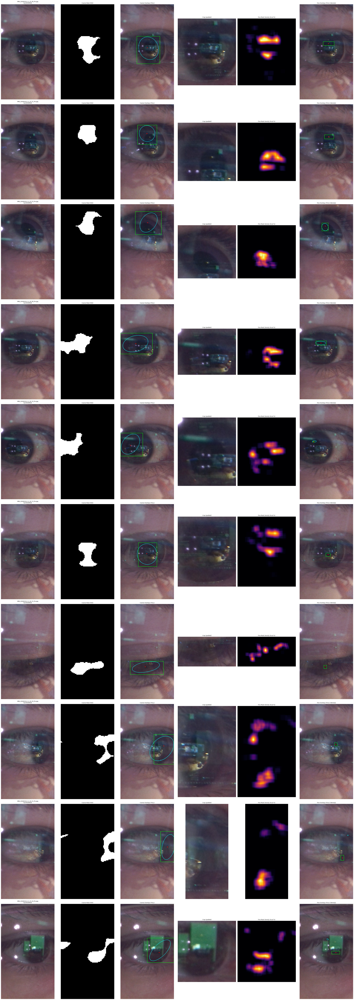

In [5]:
import sys
import os
import inspect

print("===== IMPORT DEBUG INFO =====")

print("CWD:", os.getcwd())
print("\nFirst 5 sys.path entries:")
for p in sys.path[:5]:
    print(" ", p)

print("\n--- Module Locations ---")

import eye_ops
import eye_pipeline
from eye_ops import settings as S
from eye_pipeline import io_images
from eye_pipeline import pipeline_2pass
from eye_pipeline import report

print("eye_ops package:", os.path.dirname(inspect.getfile(eye_ops)))
print("settings.py:", inspect.getfile(S))
print("io_images.py:", inspect.getfile(io_images))
print("pipeline_2pass.py:", inspect.getfile(pipeline_2pass))
print("report.py:", inspect.getfile(report))

print("===== END DEBUG INFO =====\n")

from eye_ops import settings as S
from eye_pipeline.io_images import load_rotated_images
from eye_pipeline.pipeline_2pass import run_pipeline_batch
from eye_pipeline.report import print_timing_summary

ROTATED_IMAGES, ROTATED_PATHS = load_rotated_images(max_images=200)
print("Loaded:", len(ROTATED_IMAGES))

imgs = ROTATED_IMAGES[:min(len(ROTATED_IMAGES), S.MAX_SHOW)]

PUPIL_RESULTS, TIMINGS, total_runtime = run_pipeline_batch(imgs)

print(f"Processed {len(PUPIL_RESULTS)} images.")
print_timing_summary(TIMINGS, total_runtime)


# Mask Density Helper #
import numpy as np
import cv2

def mask_density(mask01, k=31):
    # mask01 is 0/1
    m = mask01.astype(np.float32)
    dens = cv2.boxFilter(m, ddepth=-1, ksize=(k, k), normalize=True)
    return (dens * 255).astype(np.uint8)




# ==============================
# Cell 2C — Storyboard View (Full -> Coarse -> Crop -> Fine)
# ==============================

import matplotlib.pyplot as plt
import cv2

from eye_ops.overlay import draw_pupil_overlay_on_full
from eye_ops.crop_map import crop_rotated_by_green_bbox, apply_padding
from eye_ops import settings as S

rows = len(PUPIL_RESULTS)
plt.figure(figsize=(36, rows * 10.0))  # 6 cols

for r, res in enumerate(PUPIL_RESULTS):
    full = ROTATED_IMAGES[r]
    title = ROTATED_PATHS[r].name if "ROTATED_PATHS" in globals() else f"img_{r}"

    coarse = res.get("coarse", None)
    fine = res

    # --- ensure we have a crop image (prefer stored) ---
    crop_bgr = res.get("crop_bgr", None)
    if crop_bgr is None:
        src_for_crop = coarse if coarse is not None else fine
        _, bb = crop_rotated_by_green_bbox(full, src_for_crop)
        if bb is not None:
            bb_pad = apply_padding(bb, full.shape, S.PAD_PX, S.PAD_REL)
            if bb_pad is not None:
                X0, Y0, X1, Y1 = bb_pad
                crop_bgr = full[Y0:Y1, X0:X1].copy()

    # --- overlays mapped onto FULL image ---
    full_coarse_viz = draw_pupil_overlay_on_full(full, coarse, draw_bbox=True) if coarse else full.copy()
    full_fine_viz   = draw_pupil_overlay_on_full(full, fine,   draw_bbox=True) if fine else full.copy()

    # --- Column 1: Full rotated ---
    ax = plt.subplot(rows, 6, r*6 + 1)
    ax.imshow(cv2.cvtColor(full, cv2.COLOR_BGR2RGB))
    ax.set_title(f"{title}\nFull ROTATED", fontsize=9)
    ax.axis("off")

    # --- Column 2: Coarse mask (ROI space) ---
    ax = plt.subplot(rows, 6, r*6 + 2)
    if coarse is not None:
        ax.imshow(coarse["mask_pct"], cmap="gray")
        ax.set_title("Coarse Mask (ROI)", fontsize=9)
    else:
        ax.set_title("Coarse Mask: None", fontsize=9)
    ax.axis("off")

    # --- Column 3: Coarse overlays on FULL ---
    ax = plt.subplot(rows, 6, r*6 + 3)
    ax.imshow(cv2.cvtColor(full_coarse_viz, cv2.COLOR_BGR2RGB))
    ax.set_title("Coarse Overlays (FULL)", fontsize=9)
    ax.axis("off")

    # --- Column 4: Cropped (padded) ---
    ax = plt.subplot(rows, 6, r*6 + 4)
    if crop_bgr is not None:
        ax.imshow(cv2.cvtColor(crop_bgr, cv2.COLOR_BGR2RGB))
        ax.set_title("Crop (padded)", fontsize=9)
    else:
        ax.set_title("Crop: None", fontsize=9)
    ax.axis("off")

    # --- Column 5: Fine mask (crop space) ---
    ax = plt.subplot(rows, 6, r*6 + 5)
    dens = mask_density(fine["mask_pct"], k=31)
    ax.imshow(dens, cmap="inferno")
    ax.set_title("Fine Mask Density (local %)", fontsize=9)
    ax.axis("off")

    # --- Column 6: Fine overlays on FULL ---
    ax = plt.subplot(rows, 6, r*6 + 6)
    ax.imshow(cv2.cvtColor(full_fine_viz, cv2.COLOR_BGR2RGB))
    tag = "density" if fine.get("density_u8") is not None else "mask"
    ax.set_title(f"Fine Overlays (FULL) [{tag}]", fontsize=9)
    ax.axis("off")
    

plt.tight_layout()
plt.show()
